# Semesterprojekt: Umsatzvorhersage

**Fach:** Data Mining & Grundlagen Maschinelles Lernen 1  
**Semester:** Wintersemester 2023/24

**Teammitglieder**

- Matrikelnummer: 86334
- Matrikelnummer: 85698
- Matrikelnummer: 86165
- Matrikelnummer: 85194

## Inhaltsverzeichnis

2. [[Packages & Einstellungen](#abschnitt-2)
   
    2.1 [Packages](#unterabschnitt-2.1)
   
    2.2 [Dokumenteneinstellung](#unterabschnitt-2.2)
   
3. [Vorverarbeitung](#abschnitt-3)
5. [Vorverarbeitung](#abschnitt-5)
6. 
    5.1 [Unterabschnitt 2.1](#unterabschnitt-5.1)
7. [Abschnitt 6](#abschnitt-6)

## Vorverarbeitung

### Packages

In [6]:
# Dokumenten Packages
from IPython.display import display, HTML

import pkg_resources
import random
import numpy as np
import pandas as pd
import missingno as mso
import plotly.express as px
from datetime import datetime, timedelta


# Packages für Sklearn
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, accuracy_score

# Linear Models
from sklearn.linear_model import LinearRegression, Ridge, Lasso

# Tree-based Models
from sklearn.tree import DecisionTreeRegressor
# Ensemble Models
from sklearn.ensemble import RandomForestRegressor

In [7]:
# Liste der verwendeten Pakete in deinem Code
packages_used = [
    'IPython',
    'numpy',
    'pandas',
    'missingno',
    'plotly.express',
    'sklearn',
    'scikit-learn'
]

# Funktion, um die Version eines Pakets zu erhalten
def get_package_version(package):
    try:
        return pkg_resources.get_distribution(package).version
    except pkg_resources.DistributionNotFound:
        return f"{package} not found"

# Ausgabe der Paketversionen
for package in packages_used:
    version = get_package_version(package)
    print(f"{package}: {version}")

IPython: 8.13.2
numpy: 1.24.3
pandas: 2.1.1
missingno: 0.5.2
plotly.express: plotly.express not found
sklearn: sklearn not found
scikit-learn: 1.3.0


In [8]:
import pandas as pd# Pandas Einstellungen
pd.set_option("display.max_rows", 500)
pd.set_option("display.max_columns", 500)
pd.set_option("display.width", 1000)

# Notebook Einstellungen
display(HTML("<style>.container { width:100% !important; }</style>"))

# Farben für Plotly 
cds = px.colors.qualitative.G10

### Test

In [102]:
test = pd.read_csv('Daten/dmml1_test.csv')
test.head(5)

,Store ID,DayOfWeek,Date,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,1,1,0,1
1,1,4,2015-07-30,1,1,0,1
2,1,3,2015-07-29,1,1,0,1
3,1,2,2015-07-28,1,1,0,1
4,1,1,2015-07-27,1,1,0,1


### Stores und Sales

In [9]:
stores = pd.read_csv('Daten/dmml1_stores.csv')
sales = pd.read_csv('Daten/dmml1_sales.csv')

def preprocessing_sales(sales: pd.DataFrame) -> pd.DataFrame:
    #Rename StoreID
    sales.rename(columns={'Store ID':'StoreID'}, inplace=True)
    #Ändern Date zu datetime
    sales['Date'] = pd.to_datetime(sales['Date'], errors='coerce', format='%Y-%m-%d')

    #One hot encoding IsHoliday
    sales["IsHoliday"] = (sales['StateHoliday'] != "0") | (sales['SchoolHoliday'] != 0)
    sales["IsHolidayGeneral"] = (sales['StateHoliday'] == "a")
    sales["IsHolidayEaster"] = (sales['StateHoliday'] == "b")
    sales["IsHolidayChristmas"] = (sales['StateHoliday'] == "c")
    sales["SchoolHoliday"] = (sales['SchoolHoliday'] != 0)

    #Drop Columns sales
    sales = sales.drop(
        columns=["StateHoliday"]
    )

    return sales

def preprocessing_stores(stores: pd.DataFrame) -> pd.DataFrame:
    # Store ID auf Sore_ID ändern
    stores.rename(columns={'Store ID':'StoreID'}, inplace=True)

    # Ändern zu Datetime von CompetitionOpenSinceYear, CompetitionOpenYear
    # stores['CompetitionOpenSinceYea'] = pd.to_datetime(stores['CompetitionOpenSinceYear'], errors='coerce', format='%Y')
    # stores['CompetitionOpenYear'] = pd.to_datetime(stores['CompetitionOpenSinceYear'], errors='coerce', format='%Y')
    # stores['CompetitionOpenYear'] = stores['CompetitionOpenSinceYear']

    # Errechnen des Promotion Start Dates
    stores["Promo2SinceWeek"] = stores[stores["Promo2"] == 1]["Promo2SinceWeek"].astype(int).astype(str)
    stores["Promo2SinceYear"] = stores[stores["Promo2"] == 1]["Promo2SinceYear"].astype(int).astype(str)
    stores["Promo2StartDate"] = pd.to_datetime(stores["Promo2SinceYear"] + stores["Promo2SinceWeek"] + "0", format="%Y%W%w", errors="coerce")

    #Drop Columns
    stores = stores.drop(
        columns=["Promo2SinceWeek", "Promo2SinceYear", "PromoInterval", 'CompetitionOpenSinceYear', 'CompetitionOpenSinceMonth'],
    )

    # CompetionDistance na Werte zu mean Werte ändern  
    stores["CompetitionDistance"] = stores.CompetitionDistance.fillna(stores.CompetitionDistance.mean())

    #Ändern von CompetitionDistance bei StoreID, da Annahme falsche Daten (CompetionOpenSince 1900.01.01)
    stores.loc[stores['StoreID']==207, 'CompetitionDistance'] = stores.CompetitionDistance.mean()

    return stores


def preprocessing(sales: pd.DataFrame, stores: pd.DataFrame) -> pd.DataFrame:
    sales = preprocessing_sales(sales)
    stores = preprocessing_stores(stores)

    #Sales und Store merge
    sales_store = pd.merge(sales, stores, left_on='StoreID', right_on='StoreID', how='inner')

    #Promo2RunTime errechnen
    sales_store["Promo2RunTime"] = (sales_store["Date"] - sales_store["Promo2StartDate"]).dt.days
    sales_store["Promo2RunTime"] = sales_store.Promo2RunTime.fillna(0)

    #Drop Columns sales_store 
    sales_store = sales_store.drop(
        columns=["Promo2StartDate", 'Customers']
    )

    #Assortment a,b,c in basic, extra und extended umbennen
    assortment_mapping = {'a': 'basic', 'b': 'extra', 'c': 'extended'}
    sales_store['Assortment'] = sales_store['Assortment'].replace(assortment_mapping)

    #Neues Feature: Monat
    sales_store['Month'] = sales_store['Date'].dt.month
    sales_store['Month'] = sales_store['Month'].replace({
        1: 'Januar',
        2: 'Februar',
        3: 'März',
        4: 'April',
        5: 'Mai',
        6: 'Juni',
        7: 'Juli',
        8: 'August',
        9: 'September',
        10: 'Oktober',
        11: 'November',
        12: 'Dezember'})

    return sales_store

sales_store = preprocessing(sales, stores)
sales_store.head(3)

,StoreID,DayOfWeek,Date,Sales,Open,Promo,SchoolHoliday,IsHoliday,IsHolidayGeneral,IsHolidayEaster,IsHolidayChristmas,StoreType,Assortment,CompetitionDistance,Promo2,Promo2RunTime,Month
0,1,4,2015-04-30,6884,1,1,False,False,False,False,False,a,basic,570.0,1,1852.0,April
1,1,3,2015-04-29,6764,1,1,False,False,False,False,False,a,basic,570.0,1,1851.0,April
2,1,2,2015-04-28,6861,1,1,False,False,False,False,False,a,basic,570.0,1,1850.0,April


## Aufgabe 1

### 1. Wie viele Datenpunkte gibt es pro Store?

In [104]:
sales_group_store =sales_store.groupby('StoreID').apply(lambda x: x.shape[1])
assert(sales_group_store.nunique() == 1)
print(f'Jeder Store hat genau {sales_group_store.unique()[0]} (9 ohne Modifizierung) Datenpunkte in Sales')

Jeder Store hat genau 17 (9 ohne Modifizierung) Datenpunkte in Sales


### 2. Visualisieren Sie die Verteilung der Verkaufszahlen für einige zufällig ausgewählte Stores und beschreiben Sie typische Muster, die Sie erkennen.

In [105]:
# Sales pro Tag von 4 Stores

# Sample aus Sales mit 4 Stores
random_store_ids = random.sample(sales_store["StoreID"].unique().tolist(), 4) # vier random StoreIDs
sales_sample = sales_store[(sales_store["StoreID"].isin(random_store_ids)) & (sales_store["Open"] == 1)] # Nur plotten, für Open == 1

# Visualisierung
sales_sample_fig = px.line(
    sales_sample,
    x="Date",
    y="Sales",
    color="StoreID",
    color_discrete_sequence=cds, 
    hover_data=["DayOfWeek", "Date", "IsHoliday"],
    title="Umsatz pro Tag für eine Stichprobe"
)

sales_sample_fig.show()

<div class="alert alert-block alert-success">
Beschreibung: 
Zur Weihnachtsszeit erhöhen sich die Umsätze (Anfang Dezember bis meistens 23.Dezember).
Leichte Erhöhungen sind auch zur Osternzeit (im März) zu erkennen.

Außerdem sieht man klare "Peaks" innerhalb jeder Woche: Der höchste Umsatz wird meist Montags gemacht.

Über das Jahr sind die höchstem Umsätze somit größtenteils an den letzen beiden Montagen vor Weihnachten.</div>


In [106]:
# Boxplot für Sales von allen Stores pro Monat

fig = px.box(sales_store, x='Month', y='Sales', title='Sales pro Monat', color_discrete_sequence=cds,
             category_orders={"Month": sales_store.groupby("Month")["Sales"].median().sort_values(ascending=False).index}) # nach höchstem Median sortieren

fig.show()

<div class="alert alert-block alert-info">
Beschreibung: 
Die Monate mit den höchsten Umsätzen (höchstem Median) sind: Dezember, Novemeber und Juli. 

Das Modell wird die Unterschiede zwischen den einzelnen Tagen gut lernen können durch das Feature "DayOfWeek", die Unterschiede der Umsätze bpsw. durch Weihnachten können durch das Feature "Month" gelernt werden. 
Doch problematisch kann dadurch sein, dass das Modell wegen der Weihnachtszeit im ganzen Monat Dezember hohe Zahlen vorraussagen wird, wobei die hohen Umsätze meist nur in den zwei Wochen vor Weihnachten entstehen. Deswegen schauen wir uns noch die einzelnen Wochen an: </div>

In [107]:
# Sales pro Woche für alle Stores

# Durchschnittliche Sales pro Woche berechnen 
average_sales_per_week = sales_store.resample('W-Mon', on='Date')['Sales'].mean().reset_index()

# Start- und Endpunkt jeder Woche extrahieren
average_sales_per_week['WeekPeriod'] = (
    average_sales_per_week['Date'].dt.strftime('%d.%m.') + ' - ' +
    (average_sales_per_week['Date'] + pd.DateOffset(days=6)).dt.strftime('%d.%m.')
)

# Visualisierung
average_sales_per_week_fig = px.line(
    average_sales_per_week,
    x="Date",
    y="Sales",
    color_discrete_sequence=cds,
    title="Average Sales per week",
    hover_data=["WeekPeriod", "Sales"],
    height=600
)

# Modus auf 'lines+markers' setzen
average_sales_per_week_fig.update_traces(mode='lines+markers')

average_sales_per_week_fig.show()

<div class="alert alert-block alert-info">
Beschreibung: Hier wird die unterschiedliche Verteilung der Umsätze innerhalb der Monate sehr deutlich. Vorallem im Dezember ist eine starke Differenz zwischen der Zeit vor und nach Weihnachten vorzufinden. Es gibt auch weitere deutliche Peaks, jedoch ist es überflüssig hierzu Features zu generieren, vorallem da keine jährliche Regelmäßigkeit vorzufinden ist. Bspw. gab es vom 04.05 - 10.05. sehr hohe Umsätze, wobei 2013 die Umsätze zur gleichen Zeit im Durchschnitt liegen. 

In der ersten Visualsierung konnte man öfters hohe Umsätze zur Ostern Zeit vorfinden. Hier sieht man nur im Jahr 2013 hohe Umsätze durch Ostern (25.03 bis 31.03). In den anderen Jahren scheint Ostern kein Einfluss zu haben. Dies kann daran liegen, dass die Geschäfte unterschiedliche Umsätze an Ostern machen.</div>

<div class="alert alert-block alert-success">
Fazit: Man kann neue Features "BeforeEaster","BeforeChristmas" und "AfterChristmas" generieren, die man anhand der Spalten "IsHolidayEaster" und "IsHolidayChristmas" berechent. Denn die Umsätze durch diese Feiertage sind vorallem vor den Feiertagen und nicht an den Feiertagen- (Siehe Aufgabe 3)
</div>

### 3. Beschreiben Sie einige prägnante Zusammenhänge, die Ihnen zwischen verschiedenen Features auffallen.

#### Zusammenhang Features "DayOfWeek", "Open" und "StoreID"

In [108]:
# Nach DayOfWeek Gruppieren und Anteil der geöffneten Geschäfte berechnen
open_anteile = sales_store.groupby('DayOfWeek')['Open'].value_counts(normalize=True).mul(100).rename('Anteil geöffnete Geschäfte').reset_index()

# Nach geöffneten Geschäften filtern
open_anteile = open_anteile[open_anteile['Open'] == 1]

# Prozentzahl Runden
open_anteile['Anteil geöffnete Geschäfte'] = open_anteile['Anteil geöffnete Geschäfte'].round(2)

# Visualisieren
fig = px.bar(open_anteile, x='DayOfWeek', y='Anteil geöffnete Geschäfte', 
            title='Prozentsatz geöffneter Geschäfte nach Wochentag', color_discrete_sequence=cds)
            

fig.show()


# Welche Geschäfte haben Sonntags offen?
sundays_open = sales_store[(sales_store['DayOfWeek'] == 7) & (sales_store['Open'] == 1)]['StoreID'].unique()
print(f"Die Geschäfte mit ID {sundays_open} haben auch Sonntags offen. Ansonsten haben die meisten Geschäfte Sonntags geschlossen")

Die Geschäfte mit ID [ 19  30  73 168 218 238 297] haben auch Sonntags offen. Ansonsten haben die meisten Geschäfte Sonntags geschlossen


In [109]:
# Wann genau haben diese 7 Geschäfte Sonntags offen?

# DataFrame filtern nach Geschäften die Sonntags offen haben und nur DayOfWeek = Sonntag ausgeben
sales_sundays = sales_store[(sales_store["StoreID"].isin(sundays_open)) & (sales_store['DayOfWeek'] == 7)]

# Visualisierung
sales_sundays_fig = px.line(sales_sundays, x="Date", y="Sales", color="StoreID",
                           hover_data=['DayOfWeek', 'Date'],
                           title='Sales an Sonntagen',
                           color_discrete_sequence=cds)

# Diagramm anzeigen
sales_sundays_fig.show()


Die Stores mit ID 19, 297 und 168 haben immer Sonntags offen.
Die andern Stores (30, 73, 218 und 238) haben generell Sonntags offen außer im Winter (teilweise).

#### Zusammenhang Features "Promo", "Promo2" und "Sales"

In [110]:
fig = px.histogram(sales_store, x='Sales', color='Promo', marginal='box', nbins=25, facet_col='Promo', color_discrete_sequence=cds)
fig.update_layout(title='Distribution of Sales with Promo',
                  xaxis_title='Sales',
                  yaxis_title='Count')

fig.show()

In [111]:
fig = px.histogram(sales_store, x='Month', y='Sales',
                   color='Promo2',
                   facet_col='Promo',
                   facet_row=sales_store['Date'].dt.year.astype(str),
                   color_discrete_sequence=cds)
fig.update_layout(title='Sales Analysis',
                  xaxis_title='Month',
                  yaxis_title='Sales',
                  showlegend=True)

fig.show()

#### Zusammenhang Features "StoreType" und "Assortment"

In [112]:
# Gruppierung nach 'StoreType' und 'Assortment' und Anzahl zählen 
grouped_data = sales_store.groupby(['StoreType', 'Assortment']).size().reset_index(name='Anteile')

# Visualisierung 
fig = px.histogram(grouped_data, x='StoreType', y='Anteile', color='Assortment',
             barnorm = "fraction",
             title='Abhängigkeit zwischen StoreType und Assortment',
             color_discrete_sequence=cds)

fig.show()

In [113]:
# Gruppierung nach 'StoreType' und 'Assortment' und Anzahl zählen 
grouped_data = sales_store.groupby(['StoreType', 'Assortment']).size().reset_index(name='Anteile')

# Visualisierung 
fig = px.histogram(grouped_data, x='StoreType', y='Anteile', color='Assortment',
             title='Häufigkeit von StoreType und Assortment', color_discrete_sequence=cds)

fig.show()

#### Zusammenhang Features "Sales" und "CompetitionDistance"

In [114]:
# Zeilen mit "Open" = 1 
filtered_sales = sales_store[sales_store['Open'] == 1]

# Gruppieren nach 'StoreID' und Mean aggregieren für 'Sales' und Median für 'CompetitionDistance'
sales_competitiondistance = filtered_sales.groupby('StoreID').agg({
    'Sales': 'mean',
    'CompetitionDistance': 'median'
}).reset_index()

# Visualisierung 
fig = px.scatter(sales_competitiondistance, x='CompetitionDistance', y='Sales', title='Durchschnittlicher Verkauf pro Store und zugehörige CompetitionDistance', color_discrete_sequence=cds)
fig.show()


<div class="alert alert-block alert-info">
Beschreibung: Die Grafik zeigt, dass bei hoher Competition Distance die Umsätze eher niedrig sind. 
Bei niedriger Competition Distance kommen sowohl niedrige, als auch hohe Umsätze vor.
</div>

<div class="alert alert-block alert-warning">
Vermutung: Niedrige Competition Distances kommen vor allem in größeren Städten vor, wo auch die Einwohnerzahl höher ist und somit auch hohe Umsätze vorkommen können. Hohe Competition Distances können bspw. in Dörfern vorkommen, wo durch die niedrige Einwohnerzahl die Umsätze meist nicht besonders hoch sind.
</div class="sven stinkt?">

#### Zusammenhang Features "Sales", "Jahreszeiten" und "StoreType"

In [115]:
sales_store_1_3 = sales_store.copy()


sales_store_1_3['Year'] = sales_store_1_3['Date'].dt.year

# Neues Feature: Jahreszeit
sales_store_1_3['Jahreszeit'] = sales_store_1_3['Month']
sales_store_1_3['Jahreszeit'] = sales_store_1_3['Jahreszeit'].replace({
    'Januar':'Winter',
    'Februar':'Winter',
    'März':'Frühling',
    'April':'Frühling',
    'Mai':'Frühling',
    'Juni':'Sommer',
    'Juli':'Sommer',
    'August':'Sommer',
    'September':'Herbst',
    'Oktober':'Herbst',
    'November':'Herbst',
    'Dezember':'Winter'})

px.box(
    sales_store_1_3,
    x="Jahreszeit",
    y="Sales",
    title="Aufteilung nach Jahreszeiten",
    color="StoreType",
    facet_col="Year",
    facet_col_spacing=0.05,
    color_discrete_sequence=cds
)


<div class="alert alert-block alert-info">
Beschreibung: Es fällt auf das das Geschäftstyp B durchschnittlich den Höchsten Median hat, allerdings nicht so viele Außreiser nach oben ausweist und gleichzeitig keinen Store mit keinen Sales hat.
Die Anderen Geschäftstypen sind vom Median fast identisch entscheiden sich aber oft leicht, und manchmal stärker durch die Ausreißer nach oben.
Dies könnte durch dadurch zu erklären sein, dass der Geschäftstyp B der einzige ist, welcher 'extra' im Assortment anbietet.
Wichtig zu beachten ist, dass der Geschäftstyp B mit Abstand den kleinsten Teil der Stores ausmacht und somit durch weniger Außreiser verzerrt werden kann.</div>

## Aufgabe 2 & 3

### Behandlung von Ausreißern und fehlenden Werten.

#### Unkorrigierte Nullwerte Tabelle

<Axes: >

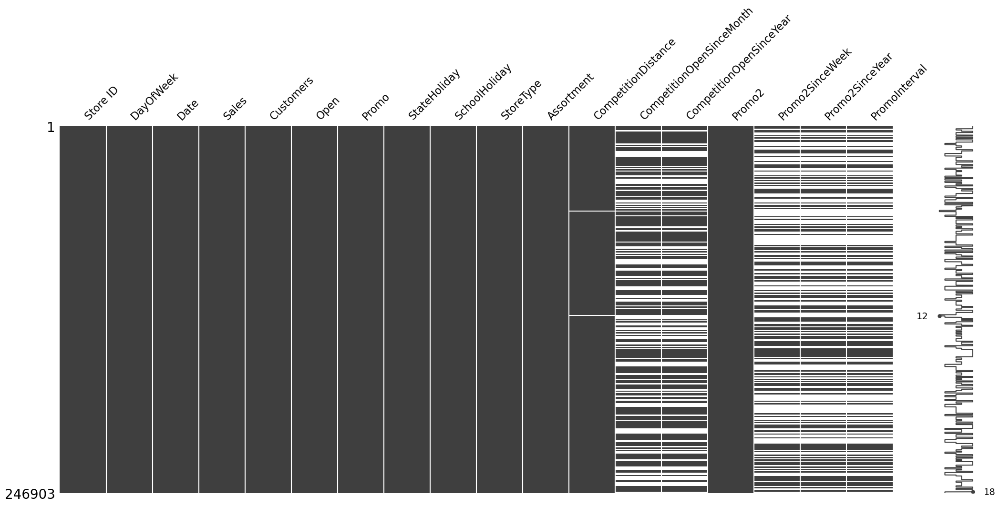

In [10]:
# Kontrollieren auf Nullwerte nach preprocessing
_stores_unkorrigiert = pd.read_csv('Daten/dmml1_stores.csv')
_sales_unkorrigiert = pd.read_csv('Daten/dmml1_sales.csv')
_sales_store_unkorrigiert = pd.merge(_sales_unkorrigiert, _stores_unkorrigiert, left_on='Store ID', right_on='Store ID', how='inner')
mso.matrix(_sales_store_unkorrigiert)

#### Korrigierte Nullwerte Tabelle

<Axes: >

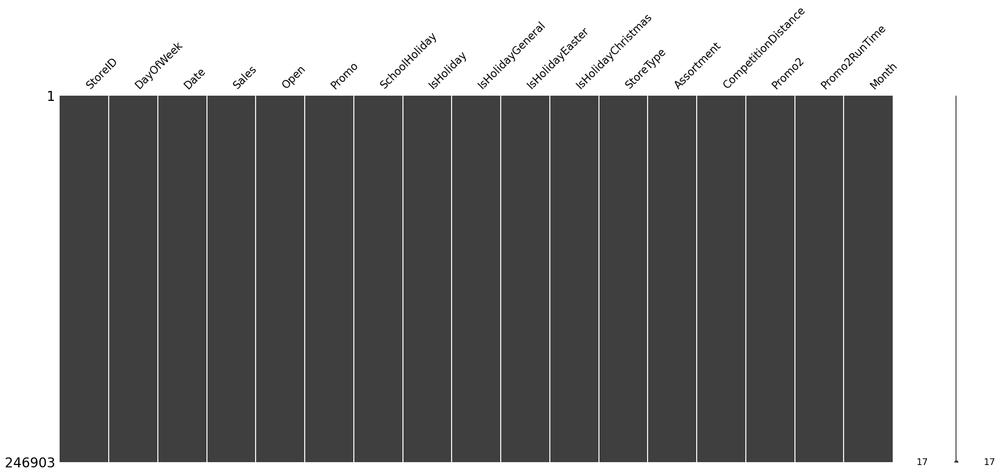

In [11]:
mso.matrix(sales_store)

#### Fehlende Werte
<div class="alert alert-block alert-info">
Jede Zeile die 'Promo2' auf 0 stehen hat bei "Promo2SinceWeek", "Promo2SinceYear", "PromoInterval", NAN Werte. Die Spalten wurden ersetz durch die Spalte 'Promo2RunTime' wo die Zeilen mit Nan Werten 0 bekommen. <br>
'CompetitionOpenSinceYear', 'CompetitionOpenSinceMonth' wurden rausgenommen, da sie wenig Aussagekraft und viele NAN Werte haben
</div>

#### Ausreißer
<div class="alert alert-block alert-info">
Um Ausreißer zu finden, wurden einige Visualisierungen (Vor allem Scatter Plots) erstellt und untersucht. 
Folgende Spalten wurden auf Ausreißer untersucht: 
	- Sales 
	- Customers
	- CompetitionOpenYear
	- CompetitionDistance
	- Promo2SinceYear
	- PromoInterval

Die Spalte Customer enthält einen Ausreißer (mit 7388 eingetragenen Customers). Jedoch wurde diese Spalte für das Modelltraining rausgenommen, sodass der Ausreißer keine Auswirkung hat.

Ein weiterer Ausreißer findet sich bei CompetionOpenYear, da hier für die StoreID der 01.01.1900 als Öffnungsdatum der Konkurrenz eingetragen wurde. Der gleiche Store hat eine CompetitionDistance von unrealistischen 59km. Da die Spalte CompetitionOpenYear rausgenommen wurde, ist das fehlerhafte Datum kein Problem. Für die 59km wurde der Mittelwert eingesetzt. 

Bei den Daten zu Promo wurden keine Ausreißer gefunden
</div>

### Neue Features die für die Vorhersage des Umsatzes aussagekräftig sein könnten.

#### Bereits hinzugefügte Features 

<div class="alert alert-block alert-info">
- Promo2RunTime: Wie lang lief Promo2 schon bei Zeitpunkt der Sales <br>
- IsHoliday(Eastern/Christmas): OneHotEncoding von isHoliday <br>
- Monat als neues Feature
</div>

#### Weitere neue Features 

##### Feature Gruppe - Zeitraum vor Feiertagen:

<div class="alert alert-block alert-info">

- Wochen vor / nach Weihnachten: Für Weihnachten wurde jeweils die 1/2/3 Woche vor Weihnachten implementiert sowie die erste Woche nach Weihnachten. Dafür haben wir uns entschieden, da die Umsätze vor allem um die Feiertage ungewöhnlich hoch sind.

- Woche nach Ostern: Für Ostern haben wir jeweils die Woche vor Ostern gewählt da diese, im Gegensatz zu Weihnachten, jedes Jahr anders ausfällt.
</div>

In [12]:
# Neues Feature "BeforeEaster"
# Beachte: Jedes Jahr liegt Ostern an einem unterschiedlichen Datum

days_before_easter = 7 # In Aufgabe 1 wurde beobachtet, dass meist eine Woche vor Ostern die Umsätze überdurchschnittlich sind

# Neue Spalte "BeforeEaster"
sales_store['BeforeEaster'] = False

# über jedes Jahr iterieren
for year in range(2013, 2016):
    # Daten filtern für das aktuelle Jahr
    year_data = sales_store[sales_store['Date'].dt.year == year]
    
    # Datumswerte berechnen für das aktuelle Jahr
    one_week_before_easter = year_data.loc[year_data['IsHolidayEaster'], 'Date'] - timedelta(days=days_before_easter + 1)
    last_day_before_easter = year_data.loc[year_data['IsHolidayEaster'], 'Date'] - timedelta(days=1)
    
    # True für Zeilen im 7-Tage Intervall vor Ostern
    sales_store.loc[sales_store['Date'].between(one_week_before_easter.min(), last_day_before_easter.max()) & (sales_store['Date'].dt.year == year), 'BeforeEaster'] = True




# Features zu Before Christmas: 1 week, 2 weeks, 3 weeks Before Christmas 
# --> Da in Aufgabe 1 sehr Unterschiedliche Umsätze vor Weihnachten beobachtet wurden (höchste Umsätze eine Woche vor Weihnachten)

# Neues Feature "1WeekBeforeChristmas" (16. bis 23. Dezember)
one_week_before_christmas = pd.to_datetime('16.12.', format='%d.%m.')
last_day_before_christmas = pd.to_datetime('23.12.', format='%d.%m.')

# Neue Spalte generieren; True für alle Zeilen wo Date im Inervall 16. bis 23.12 liegt
sales_store['1WeekBeforeChristmas'] = sales_store['Date'].dt.strftime('%m-%d').between(one_week_before_christmas.strftime('%m-%d'), last_day_before_christmas.strftime('%m-%d'))


# Neues Feature "2WeeksBeforeChristmas" (8. bis 15. Dezember)
two_weeks_before_christmas = pd.to_datetime('08.12.', format='%d.%m.')
two_weeks_before_christmas_end = pd.to_datetime('15.12.', format='%d.%m.')

# Neue Spalte generieren; True für alle Zeilen wo Date im Inervall 8. bis 15.12 liegt
sales_store['2WeeksBeforeChristmas'] = sales_store['Date'].dt.strftime('%m-%d').between(two_weeks_before_christmas.strftime('%m-%d'), two_weeks_before_christmas_end.strftime('%m-%d'))


# Neues Feature "3WeeksBeforeChristmas" (1. bis 7. Dezember)
three_weeks_before_christmas = pd.to_datetime('01.12.', format='%d.%m.')
three_weeks_before_christmas_end = pd.to_datetime('07.12.', format='%d.%m.')

# Neue Spalte generieren; True für alle Zeilen wo Date im Inervall 1. bis 7.12 liegt
sales_store['3WeeksBeforeChristmas'] = sales_store['Date'].dt.strftime('%m-%d').between(three_weeks_before_christmas.strftime('%m-%d'), three_weeks_before_christmas_end.strftime('%m-%d'))


# Neues Feature "AfterChristmas" (27. bis 31. Dezember)
after_christmas_start = pd.to_datetime('27.12.', format='%d.%m.')
after_christmas_end = pd.to_datetime('31.12.', format='%d.%m.')

# Neue Spalte generieren; True für alle Zeilen wo Date im Inervall 27. bis 31.12 liegt
sales_store['AfterChristmas'] = sales_store['Date'].dt.strftime('%m-%d').between(after_christmas_start.strftime('%m-%d'), after_christmas_end.strftime('%m-%d'))

### Skalierung und Encoding von Features

In [13]:
# Mithilfe von ColumnTransformer:
# 1. Entfernen der Spalte Date
# 2. One-Hot-Encoding der Spalten StoreID, DayOfWeek, StoreTyp, Assortment, Month
# 3. Sklaieren der Spalten CompetitionDistance, Promo2RunTime

column_trans = ColumnTransformer(transformers=[
                                ("Entfernen von Spalten", "drop", ["Date"]),
                                ("One-hot encoding", OneHotEncoder(handle_unknown="ignore"), ["StoreID", "DayOfWeek", "StoreType", "Assortment", "Month"]), 
                                ("Standard", StandardScaler(), ["CompetitionDistance", "Promo2RunTime"])
                                ], remainder="passthrough")


## Aufgabe 4 & 5

### Vorbereitung

In [14]:
# Funktion um Gesamtkosten für Aufgabe 5 zu berechnen

def gesamtkosten(y_pred, y_test):
    print("Aufgabe 5:")

    # Differenzen zwischen vorausgesagtem und echten Wert
    y_differences = y_pred - y_test

    # in Dataframe konvertieren
    y_differences = y_differences.to_frame(name='Differenzen')

    # Anzahl der vorkommenden starken Unter- und Überschätzungen
    amount_lt_4k = y_differences[y_differences['Differenzen'] < -4000].count().iloc[0]
    amount_bt_3k_6k = y_differences[y_differences['Differenzen'].between(3000, 6000)].count().iloc[0]
    amount_gt_6k = y_differences[y_differences['Differenzen'] > 6000].count().iloc[0]

    print(f"( -4000> : {amount_lt_4k} | 3000-6000 : {amount_bt_3k_6k} | >6000 : {amount_gt_6k}) out of {amount_lt_4k + amount_bt_3k_6k + amount_gt_6k}/{y_differences.count().iloc[0]} - {round(y_differences.count().iloc[0] / (amount_lt_4k + amount_bt_3k_6k + amount_gt_6k), 2)}%")

    # Gesamtkosten durch Unter- und Überschätzungen
    gesamtkosten = 100*amount_lt_4k + 150*amount_bt_3k_6k + 250*amount_gt_6k
    print(f"Es fallen {gesamtkosten}€ Gesamtkosten auf")

In [15]:
# Funktion um Modelle zu bewerten 

def print_evaluation(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred):
    """ Ausgabe von R2-Wert, MSE, MAE und Accuracy für Trainings- und Testset """
    r2_train = r2_score(y_train, y_train_pred)
    mse_train = mean_squared_error(y_train, y_train_pred)
    mae_train = mean_absolute_error(y_train, y_train_pred)

    r2_test = r2_score(y_test, y_test_pred)
    mse_test = mean_squared_error(y_test, y_test_pred)
    mae_test = mean_absolute_error(y_test, y_test_pred)

    print(
        "Evaluation:\n"
        f"{'':6} {'R²':>10} | {'MSE':>14} | {'MAE':>10} |  {'rows':>8} | {'columns':>8}\n"
        f"{'Train':6} {r2_train:10.5f} | {mse_train:14.2f} | {mae_train:10.2f} | {X_train.shape[0]:8}  | {X_train.shape[1]:8}\n"
        f"{'Test':6} {r2_test:10.5f} | {mse_test:14.2f} | {mae_test:10.2f} | {X_test.shape[0]:8}  | {X_test.shape[1]:8}\n"
    )

In [16]:
# Split in Trainings- und Testset
if "Sales" in sales_store:
    X = sales_store
    y = sales_store.pop("Sales")

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [17]:
# Skalierung und Transformierung anwenden
X_transformed = column_trans.fit_transform(X)
feature_names_out = column_trans.get_feature_names_out()

### Entscheidungsbaum: DecisionTreeRegressor 

#### Modelltraining

In [181]:
dt_pipe = Pipeline([("Vorverarbeitung", column_trans), ("dt", DecisionTreeRegressor())])

param_grid = {
    "dt__max_depth": range(15, 60, 8),  # Max depth is: 94
    #"dt__min_samples_split": [200, 400, 600],
    #"dt__min_samples_leaf": [100, 150, 200], - nicht wichtig 
    #"dt__max_features": [None, "sqrt", "log2"], - nicht wichtig
    #"Vorverarbeitung__Standard__with_std": [True, False]
}

gs_dt = GridSearchCV(dt_pipe, param_grid, cv=3, error_score='raise')

gs_dt.fit(X_train, y_train)

GridSearchCV(cv=3, error_score='raise',
             estimator=Pipeline(steps=[('Vorverarbeitung',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('Entfernen '
                                                                         'von '
                                                                         'Spalten',
                                                                         'drop',
                                                                         ['Date']),
                                                                        ('One-hot '
                                                                         'encoding',
                                                                         OneHotEncoder(handle_unknown='ignore'),
                                                                         ['StoreID',
                                                                          'DayOfWeek',
                                                                          'StoreType',
                                                                          'Assortment',
                                                                          'Month']),
                                                                        ('Standard',
                                                                         StandardScaler(),
                                                                         ['CompetitionDistance',
                                                                          'Promo2RunTime'])])),
                                       ('dt', DecisionTreeRegressor())]),
             param_grid={'dt__max_depth': range(15, 60, 8)})

#### Beste Parameter und Bewertung

In [182]:
# Beste Parameter
best_params = gs_dt.best_params_
print("Beste Parameter:", best_params)

# Vorhersagen für Train- und Testdaten 
y_test_pred_dt = gs_dt.predict(X_test)
y_train_pred_dt = gs_dt.predict(X_train)

# Evaluation
print_evaluation(X_train, X_test, y_train, y_test, y_train_pred_dt, y_test_pred_dt)

Beste Parameter: {'dt__max_depth': 55}
Evaluation:
               R² |            MSE |        MAE |      rows |  columns
Train     0.97988 |      323000.78 |     265.40 |   197522  |       21
Test      0.91801 |     1317266.15 |     680.04 |    49381  |       21



#### Feature Importance

In [183]:
# Wichtigste Features von Decision Tree
feature_importances_dt = gs_dt.best_estimator_['dt'].feature_importances_

# Dataframe mit Importance pro Spalte 
feature_importance__dt_df = pd.DataFrame({
    'Feature': feature_names_out,
    'Importance': feature_importances_dt
})

# Dataframe nach Importance sortieren
feature_importance__dt_df = feature_importance__dt_df.sort_values(by='Importance', ascending=False)

feature_importance__dt_df.head(5)

,Feature,Importance
328,remainder__Open,0.443198
329,remainder__Promo,0.066483
206,One-hot encoding__StoreID_207,0.039607
326,Standard__CompetitionDistance,0.031487
327,Standard__Promo2RunTime,0.027787


In [184]:
# Filtern nach Importance > 0.01
filtered_dt_df = feature_importance__dt_df[feature_importance__dt_df['Importance'] > 0.01]

# Visualsierung 
fig = px.histogram(filtered_dt_df, x='Feature', y='Importance', labels={'Importance': 'Feature Importance'}, title='Feature Importance (Values > 0.1)')
fig.show()

#### Gesamtkosten

In [4]:
gesamtkosten(y_test_pred_dt, y_test)

NameError: name 'gesamtkosten' is not defined

### Ensemble-Modell: RandomForestRegressor

#### Modelltraining

In [19]:
rf_pipe = Pipeline([
    ("Vorverarbeitung", column_trans),
    ("rf", RandomForestRegressor())
])

param_grid_rf = {
    "rf__n_estimators": range(3,6),
    # "rf__max_depth": [10, 20, 30],
    # "rf__min_samples_split": [200, 400, 600],
    # "rf__min_samples_leaf": [100, 150, 200], - nicht wichtig 
    # "rf__max_features": ["sqrt", "log2"]
    
}

gs_rf = GridSearchCV(rf_pipe, param_grid_rf, cv=3, error_score='raise', verbose=2)
gs_rf.fit(X_train, y_train)

Fitting 3 folds for each of 3 candidates, totalling 9 fits
[CV] END .................................rf__n_estimators=3; total time=  44.7s
[CV] END .................................rf__n_estimators=3; total time=  43.5s


KeyboardInterrupt: 

#### Beste Parameter und Bewertung

In [ ]:
# Beste Parameter
best_params = gs_rf.best_params_
print("Beste Parameter:", best_params)

# Vorhersagen für Train- und Testdaten 
y_test_pred_rf = gs_rf.predict(X_test)
y_train_pred_rf = gs_rf.predict(X_train)

# Evaluation
print_evaluation(X_train, X_test, y_train, y_test, y_train_pred_rf, y_test_pred_rf)

#### Feature Importance

In [ ]:
best_rf_model = gs_rf.best_estimator_['rf']

# Extrahiere die Feature Importance
feature_importances_rf = best_rf_model.feature_importances_

# DataFrame für Feature Importance erstellen
feature_importance__rf_df = pd.DataFrame({
    'Feature': feature_names_out,
    'Importance': feature_importances_rf
})

# Sortiere das DataFrame nach Importance absteigend
feature_importance_rf_df = feature_importance__rf_df.sort_values(by='Importance', ascending=False)
feature_importance_rf_df

NameError: name 'gs_rf' is not defined

In [ ]:
# Filtern nach Importance > 0.02
filtered_rf_df = feature_importance_rf_df[feature_importance_rf_df['Importance'] > 0.02]

# Visualisierung 
fig = px.hisstogram(filtered_rf_df, x='Feature', y='Importance', labels={'Importance': 'Feature Importance'}, title='Feature Importance (Values > 0.02)')
fig.show()

#### Gesamtkosten

In [ ]:
gesamtkosten(y_test_pred_rf, y_test)

Aufgabe 5:
( -4000> : 3256 | 3000-6000 : 3419 | >6000 : 47) out of 6722/49381 - 7.35%
Es fallen 850200€ Gesamtkosten auf


### Lineares Modell: Ridge

#### Modelltraining

In [146]:
# Ridge Regression Pipeline
ridge_pipe = Pipeline([
    ("Vorverarbeitung", column_trans),
    ("ridge", Ridge())
])

# Grid Search Parameter für Ridge
param_grid_ridge = {
    "ridge__fit_intercept": [False, True],  # Set fit_intercept to False for sparse data
    "ridge__alpha": [0.1, 1.0, 10.0],
    #"ridge__solver": ['auto', 'lsqr']
}

# Grid Search für Ridge und Lasso
gs_ridge = GridSearchCV(ridge_pipe, param_grid_ridge, cv=5,error_score='raise')
gs_ridge.fit(X_train, y_train)


GridSearchCV(cv=5, error_score='raise',
             estimator=Pipeline(steps=[('Vorverarbeitung',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('Entfernen '
                                                                         'von '
                                                                         'Spalten',
                                                                         'drop',
                                                                         ['Date']),
                                                                        ('One-hot '
                                                                         'encoding',
                                                                         OneHotEncoder(handle_unknown='ignore'),
                                                                         ['StoreID',
                                                                          'DayOfWeek',
                                                                          'StoreType',
                                                                          'Assortment',
                                                                          'Month']),
                                                                        ('Standard',
                                                                         StandardScaler(),
                                                                         ['CompetitionDistance',
                                                                          'Promo2RunTime'])])),
                                       ('ridge', Ridge())]),
             param_grid={'ridge__alpha': [0.1, 1.0, 10.0],
                         'ridge__fit_intercept': [False, True]})

#### Beste Parameter und Bewertung

In [1]:
# Beste Parameter
best_params = gs_ridge.best_params_
print("Beste Parameter:", best_params)

# Vorhersagen für Train- und Testdaten 
y_test_pred_ridge = gs_ridge.predict(X_test)
y_train_pred_ridge = gs_ridge.predict(X_train)

# Evaluation
print_evaluation(X_train, X_test, y_train, y_test, y_train_pred_ridge, y_test_pred_ridge)

NameError: name 'gs_ridge' is not defined

#### Features Importance

In [ ]:
# Beste Ridge-Regression-Instanz aus der GridSearchCV
best_ridge_model = gs_ridge.best_estimator_['ridge']

# Extrahiere die Koeffizienten
ridge_coefficients = best_ridge_model.coef_

# DataFrame für die Koeffizienten erstellen
ridge_coefficients_df = pd.DataFrame({
    'Feature': feature_names_out,
    'Coefficient': ridge_coefficients
})

# Sortiere das DataFrame nach Koeffizientenbetrag absteigend
ridge_coefficients_df = ridge_coefficients_df.reindex(ridge_coefficients_df['Coefficient'].abs().sort_values(ascending=False).index)
ridge_coefficients_df.head(5)


In [ ]:
# Visualsierung
fig = px.histogram(ridge_coefficients_df, x='Feature', y='Coefficient', labels={'Coefficient': 'Feature Importance'}, title='Feature Importance (Values > 0.02)')
fig.show()

#### Gesamtkosten

In [ ]:
gesamtkosten(y_test_pred_ridge, y_test)

Aufgabe 5:
( -4000> : 837 | 3000-6000 : 1010 | >6000 : 262) out of 2109/49381 - 23.41%
Es fallen 300700€ Gesamtkosten auf


### Lineares Modell: Lasso 

#### Modelltraining

In [ ]:
# Lasso Regression Pipeline
lasso_pipe = Pipeline([("Vorverarbeitung", column_trans), ("lasso", Lasso())])

# Grid Search Parameter für Lasso
param_grid_lasso = {
    #"lasso__fit_intercept": [True, False],
    "lasso__alpha": [0.1, 1.0],
    #"lasso__max_iter": [2000, 3000],
    #"lasso__selection": ['cyclic', 'random'],
    #"lasso__tol": [1e-3, 1e-2]
}

gs_lasso = GridSearchCV(lasso_pipe, param_grid_lasso, cv=5, error_score='raise')
gs_lasso.fit(X_train, y_train)

GridSearchCV(cv=2, error_score='raise',
             estimator=Pipeline(steps=[('Vorverarbeitung',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('Entfernen '
                                                                         'von '
                                                                         'Spalten',
                                                                         'drop',
                                                                         ['Date']),
                                                                        ('One-hot '
                                                                         'encoding',
                                                                         OneHotEncoder(handle_unknown='ignore'),
                                                                         ['StoreID',
                                                                          'DayOfWeek',
                                                                          'StoreType',
                                                                          'Assortment',
                                                                          'Month'])])),
                                       ('lasso', Lasso())]),
             param_grid={'lasso__alpha': [0.1, 1.0]})

#### Beste Parameter und Berwertung

In [ ]:
best_params = gs_lasso.best_params_

# R2-Score
best_r2_score = gs_lasso.best_score_

# MAE und MSE
y_pred_lasso = gs_lasso.predict(X_test)
best_mae = mean_absolute_error(y_test, y_pred_lasso)
best_mse = mean_squared_error(y_test, y_pred_lasso)

# Ausgabe der Ergebnisse
print("Beste Parameter:", best_params)
print("R2-Score:", best_r2_score)
print("MAE:", best_mae)
print("MSE:", best_mse)

Beste Parameter: {'lasso__alpha': 0.1}
R2-Score: 0.8317765829945443
MAE: 1151.2960821084757
MSE: 2727103.70411244


In [ ]:
# Beste Parameter
best_params = gs_lasso.best_params_
print("Beste Parameter:", best_params)

# Vorhersagen für Train- und Testdaten 
y_test_pred_lasso = gs_lasso.predict(X_test)
y_train_pred_lasso = gs_lasso.predict(X_train)

# Evaluation
print_evaluation(X_train, X_test, y_train, y_test, y_train_pred_lasso, y_test_pred_lasso)

#### Feature Importance

In [ ]:
# Beste lasso-Regression-Instanz aus der GridSearchCV
best_lasso_model = gs_lasso.best_estimator_['lasso']

# Extrahiere die Koeffizienten
lasso_coefficients = best_lasso_model.coef_

# DataFrame für die Koeffizienten erstellen
lasso_coefficients_df = pd.DataFrame({
    'Feature': feature_names_out,
    'Coefficient': lasso_coefficients
})

# Sortiere das DataFrame nach Koeffizientenbetrag absteigend
lasso_coefficients_df = lasso_coefficients_df.reindex(lasso_coefficients_df['Coefficient'].abs().sort_values(ascending=False).index)
lasso_coefficients_df.head(5)

In [ ]:
# Filtern nach Koeffizienten > 0
filtered_lasso_df = lasso_coefficients_df[lasso_coefficients_df['Coefficient'] > 0]

# Visualisierung 
fig = px.histogram(filtered_lasso_df, x='Feature', y='Coefficient', labels={'Coefficient': 'Feature Importance'}, title='Feature Importance (Values > 0.0)')
fig.show()

#### Gesamtkosten

In [ ]:
gesamtkosten(y_test_pred_lasso, y_test)

Aufgabe 5:
( -4000> : 743 | 3000-6000 : 707 | >6000 : 294) out of 1744/49381 - 28.31%
Es fallen 253850€ Gesamtkosten auf


### Fazit

<div class="alert alert-block alert-info">Das Ensemble Modell (der Random Forest Regressor) schneidet im Vergleich zu den anderen Modellen am besten ab, die Gesamtkosten als auch die Metriken (R^2, MSE und MAE) sind besser. <d/iv>